In [1]:
from dataset.nok_aug import NokAugDataModule
from utils.stylegan import StyleGAN2
from utils.viz import image_add_label

import torch, torchvision

from pprint import pprint
from itertools import chain

AttributeError: module 'yaml' has no attribute 'Dumper'

In [2]:
data_module = NokAugDataModule(batch_size=10, num_workers=0)
data_module.prepare_data()
data_module.setup(stage="fit")

train_data_loader = data_module.train_dataloader()

In [ ]:
def vizualize_batch(batch):
    stylegan2 = StyleGAN2()
    father, mother, child, _, _, _, f_pid, m_pid, c_pid, *_ = batch

    toPIL = torchvision.transforms.ToPILImage()
    toTensor = torchvision.transforms.PILToTensor()
    label_and_resize_fn = lambda x: image_add_label(x[0].resize((256, 256)), label=str(x[1]), font_size=50)

    ws = torch.stack([father, mother, child], dim=1).view(-1, 18, 512)
    labels = list(chain(*zip(f_pid.tolist(), m_pid.tolist(), c_pid.tolist())))
    images = stylegan2.generate_from_array(ws)
    images = list(map(label_and_resize_fn, zip(images, labels)))

    images = list(map(toTensor, images))

    return toPIL(torchvision.utils.make_grid(images, nrow=3))


In [ ]:
vizualize_batch(next(iter(train_data_loader)))

In [ ]:
vizualize_batch(next(iter(train_data_loader)))

In [3]:
def sample_from_dataset(idx, n=3):
    stylegan = StyleGAN2()
    images = []
    labels = []
    for i in range(n):
        father, mother, child, _, _, _, f_pid, m_pid, c_pid, f_w0, \
            m_w0, \
            c_w0, \
            f_w1, \
            m_w1, \
            c_w1, \
            f_m, \
            m_m, \
            c_m = train_data_loader.dataset[idx]
        images += [father, f_w0, f_w1, mother, m_w0, m_w1, child, c_w0, c_w1]
        labels += [f_pid, f"{f_m:.2}", "", m_pid, f"{m_m:.2}", "", c_pid, f"{c_m:.2}", ""]
    images = torch.stack(images, dim=0)
    images = [image_add_label(img.resize((256,256)), label, font_size=50) for img, label in zip(stylegan.generate_from_array(images), labels)]

    toPIL = torchvision.transforms.ToPILImage()
    toTensor = torchvision.transforms.PILToTensor()

    images = list(map(toTensor, images))

    return toPIL(torchvision.utils.make_grid(images, nrow=9))


/home/matjazibb/miniconda3/envs/masters/lib/python3.6/site-packages/torchvision/transforms/functional.py:169: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:143.)
  img = torch.as_tensor(np.asarray(pic))


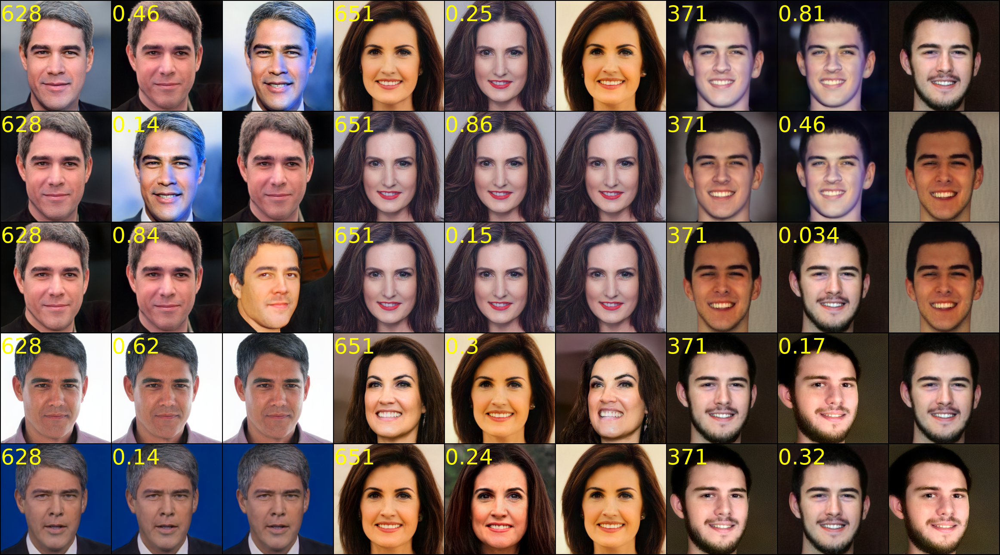

In [4]:
sample_from_dataset(35, n=5)

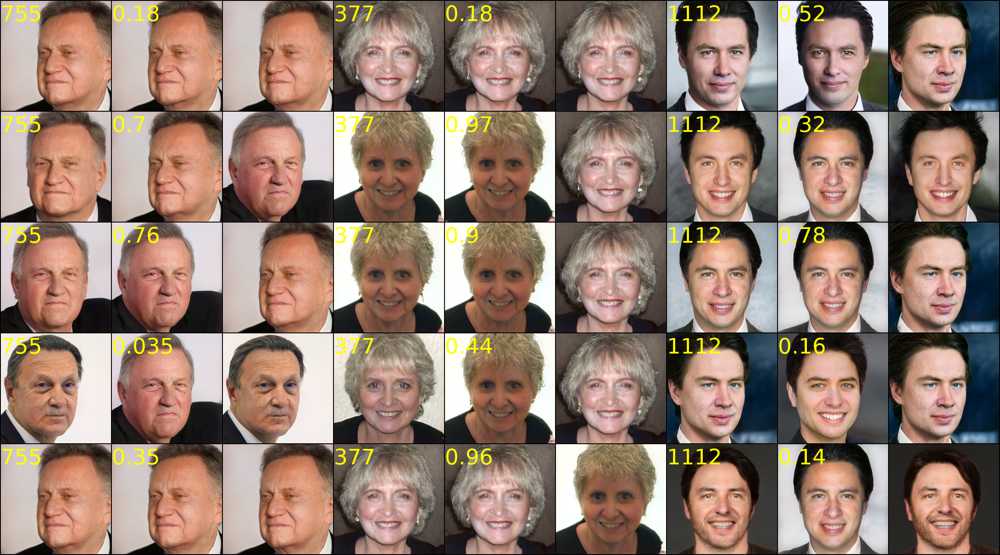

In [5]:
sample_from_dataset(30, n=5)

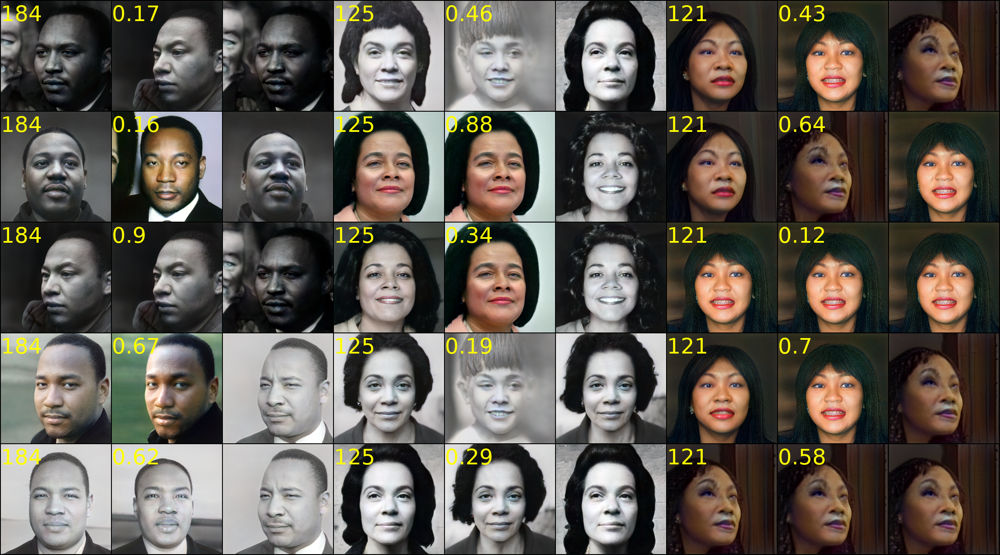

In [6]:
sample_from_dataset(100, n=5)

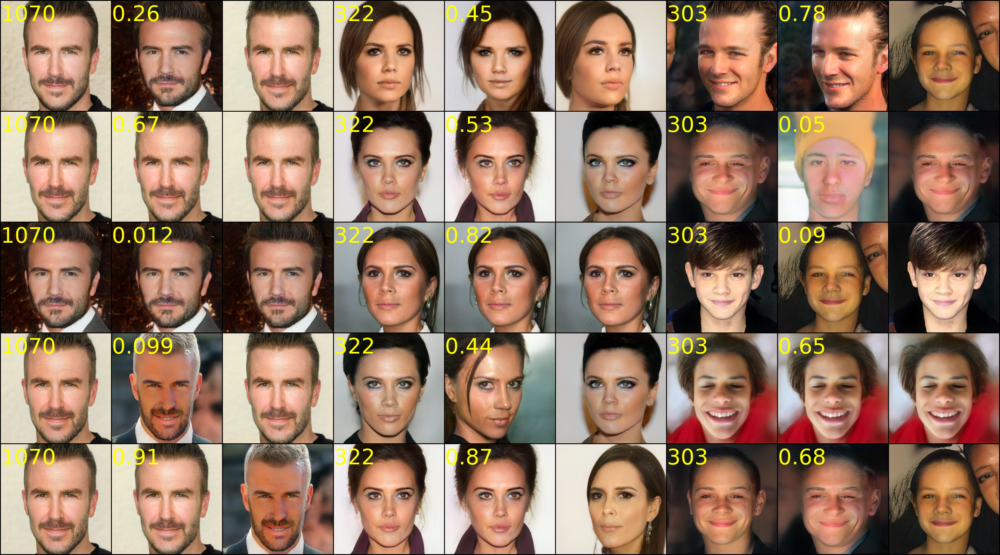

In [7]:
sample_from_dataset(21, n=5)

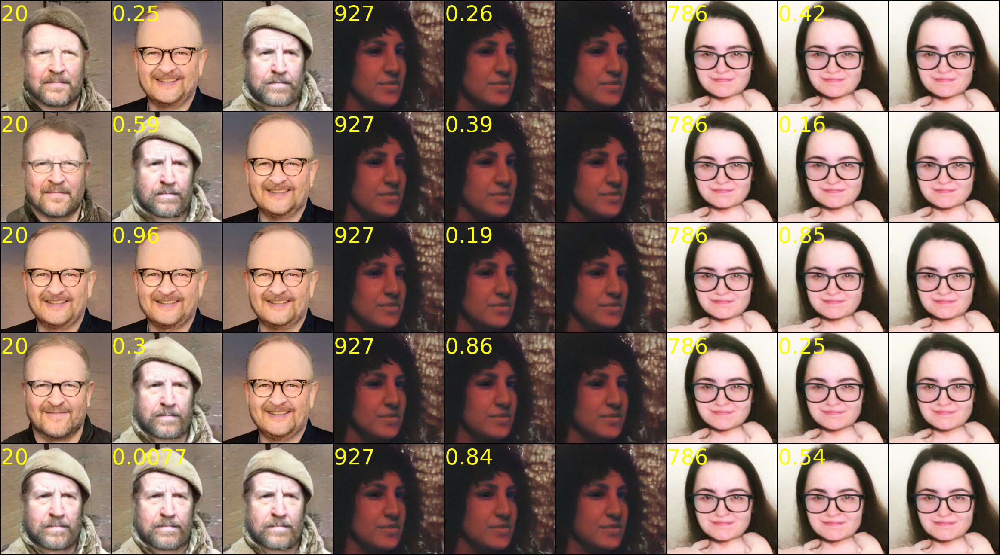

In [8]:
sample_from_dataset(20, n=5)

In [ ]:
from dataset.nok_aug import NokAugDataModule
from utils.stylegan import StyleGAN2
from utils.viz import image_add_label

import torch, torchvision

from pprint import pprint
from itertools import chain



def vizualize_batch(batch):
    stylegan2 = StyleGAN2()
    father, mother, child, _, _, _, f_pid, m_pid, c_pid, *_ = batch

    toPIL = torchvision.transforms.ToPILImage()
    toTensor = torchvision.transforms.PILToTensor()
    label_and_resize_fn = lambda x: image_add_label(x[0].resize((256, 256)), label=str(x[1]), font_size=50)

    ws = torch.stack([father, mother, child], dim=1).view(-1, 18, 512)
    labels = list(chain(*zip(f_pid.tolist(), m_pid.tolist(), c_pid.tolist())))
    images = stylegan2.generate_from_array(ws)
    images = list(map(label_and_resize_fn, zip(images, labels)))

    images = list(map(toTensor, images))

    return toPIL(torchvision.utils.make_grid(images, nrow=3))


def sample_from_dataset(idx, train_data_loader, n=3):
    stylegan = StyleGAN2()
    images = []
    labels = []
    for i in range(n):
        father, mother, child, _, _, _, f_pid, m_pid, c_pid, f_w0, \
            m_w0, \
            c_w0, \
            f_w1, \
            m_w1, \
            c_w1, \
            f_m, \
            m_m, \
            c_m = train_data_loader.dataset[idx]
        images += [father, f_w0, f_w1, mother, m_w0, m_w1, child, c_w0, c_w1]
        labels += [f_pid, f"{f_m:.2}", "", m_pid, f"{m_m:.2}", "", c_pid, f"{c_m:.2}", ""]
    images = torch.stack(images, dim=0)
    images = [image_add_label(img.resize((256,256)), label, font_size=50) for img, label in zip(stylegan.generate_from_array(images), labels)]

    toPIL = torchvision.transforms.ToPILImage()
    toTensor = torchvision.transforms.PILToTensor()

    images = list(map(toTensor, images))

    return toPIL(torchvision.utils.make_grid(images, nrow=9))


def main():
    data_module = NokAugDataModule(batch_size=10, num_workers=0)
    data_module.prepare_data()
    data_module.setup(stage="fit")

    train_data_loader = data_module.train_dataloader()

    vizualize_batch(next(iter(train_data_loader)))
    vizualize_batch(next(iter(train_data_loader)))
    sample_from_dataset(35, train_data_loader, n=5)
    sample_from_dataset(30, train_data_loader, n=5)